In [61]:
import pandas as pd
import altair as alt
alt.data_transformers.disable_max_rows()
alt.renderers.enable('jupyterlab')
import numpy as np

In [55]:
df = pd.read_csv("output/outputs_2023-01-08_v1.csv")
df = df.drop(columns = 'Unnamed: 0')
df.columns = ['Stress', 'Shear rate', 'Step time', 'Temperature', 'Normal stress',
       'pressure_ppm', 'condition_temp', 'Viscosity Actual', 'Viscosity Prediction', 'compound',
       'model']

df_melt = df.melt(id_vars = ['Stress', 'Shear rate', 'Step time', 'Temperature', 'Normal stress',
       'pressure_ppm', 'condition_temp', 'compound',
       'model'])

df_melt

,Stress,Shear rate,Step time,Temperature,Normal stress,pressure_ppm,condition_temp,compound,model,variable,value
0,0.029770,1.000040,39.9688,25.004000,0.468451,1000.0,25.000000,SAV 333,Linear Regression,Viscosity Actual,0.029769
1,0.000688,1.259070,80.0469,25.010000,0.464201,1000.0,25.000000,SAV 333,Linear Regression,Viscosity Actual,0.000546
2,0.010087,1.584950,120.2340,25.003000,0.464374,1000.0,25.000000,SAV 333,Linear Regression,Viscosity Actual,0.006364
3,0.009995,1.995150,160.2190,25.000000,0.462455,1000.0,25.000000,SAV 333,Linear Regression,Viscosity Actual,0.005010
4,0.010382,2.511790,200.3910,25.000000,0.463691,1000.0,25.000000,SAV 333,Linear Regression,Viscosity Actual,0.004133
...,...,...,...,...,...,...,...,...,...,...,...
104065,1.372170,5.986721,1083.1200,4.381889,0.277452,600.0,4.382027,SAV10,Linear Regression on log features of Shear rat...,Viscosity Prediction,-0.130986
104066,1.811600,6.216979,1123.2500,4.381964,0.272756,600.0,4.382027,SAV10,Linear Regression on log features of Shear rat...,Viscosity Prediction,-0.140419
104067,2.389860,6.447239,1163.7200,4.381939,0.264701,600.0,4.382027,SAV10,Linear Regression on log features of Shear rat...,Viscosity Prediction,-0.136327
104068,3.103090,6.677496,1203.8300,4.381814,0.247215,600.0,4.382027,SAV10,Linear Regression on log features of Shear rat...,Viscosity Prediction,-0.178771


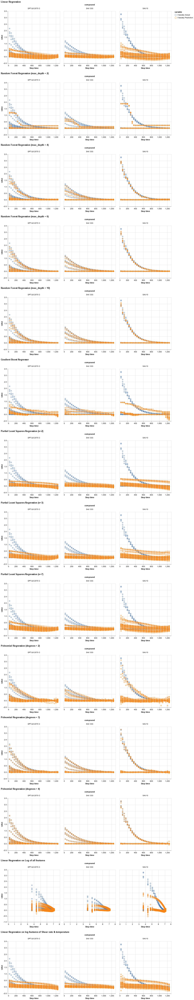

In [62]:
charts = []
for models in df['model'].unique():

    charts.append(alt.Chart(df_melt.query('model == @models')).mark_point(opacity = 0.6).encode(
        alt.Y('value'),
        alt.X('Step time'),
        alt.Color('variable'),
        alt.Facet('compound')).properties(width = 300, title = models))
                  
alt.vconcat(*charts)

In [64]:
alt.vconcat(*charts).save('output/chart1.json')
alt.vconcat(*charts).save('output/chart2.html')